In [2]:
# Imports
from importlib import reload
from matplotlib.backends.backend_pdf import PdfPages
from scipy import sparse
from scipy import stats
from sklearn import neighbors
from sklearn.decomposition import PCA
from sklearn.feature_selection import f_regression
from sklearn.linear_model import LinearRegression
from sklearn.manifold import TSNE
import sklearn
from sklearn.metrics import pairwise_distances
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.metrics.pairwise import cosine_distances
from sklearn.metrics.pairwise import rbf_kernel
from sklearn.neighbors import BallTree
from sklearn.neighbors import NearestNeighbors
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import Normalizer
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import normalize
from sklearn.preprocessing import KBinsDiscretizer
from umap import UMAP
import anndata as ad
import json
import math
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import polars as pl
import polars.selectors as cs
import scanpy as sc
import seaborn as sns
import sklearn as sk
import statsmodels.api as sm
import sys
import typing
import umap
import warnings
warnings.filterwarnings('ignore')
# local imports
import slamutils
import re



from scipy.sparse import csr_array, csr_matrix
from scipy.sparse.csgraph import maximum_bipartite_matching

import mygene
import toolz
from toolz import curry
from scipy.stats import mannwhitneyu, brunnermunzel
from sklearn.metrics.pairwise import pairwise_kernels
import scipy
import time
from scipy import linalg

In [3]:
from scipy.sparse.csgraph import shortest_path

In [4]:
#import scvelo as scv
import matplotlib

class mplDeprecation(UserWarning):
    pass

matplotlib.cbook.mplDeprecation = mplDeprecation

import scvelo as scv

In [5]:
import os
save_dir = "./plots/RPE1/"
save_dir = os.path.abspath(save_dir)
if not os.path.exists(save_dir):
    os.makedirs(save_dir)
print(save_dir, os.path.exists(save_dir))

/home/zelhar/my_gits/exovelo_paper/code/plots/RPE1 True


In [6]:
sc.set_figure_params(dpi=60,)
adata = sc.read_h5ad("./data/rpe1-pulse-varnames-nodmso.h5ad",)
adata.var_names_make_unique()
adata

AnnData object with n_obs × n_vars = 2793 × 11463
    obs: 'Plate_Id', 'Condition_Id', 'Well_Id', 'RFP_log10_corrected', 'GFP_log10_corrected', 'Cell_cycle_possition', 'Cell_cycle_relativePos', 'exp_type', 'time'
    var: 'Gene_Id', 'query', 'scopes', '_id', '_score', 'symbol'
    layers: 'new', 'old', 'sl', 'spliced', 'su', 'total', 'ul', 'unspliced', 'uu'

In [7]:
sc.pp.filter_cells(adata, min_genes=200)
sc.pp.filter_genes(adata, min_cells=50)
adata

AnnData object with n_obs × n_vars = 2793 × 11450
    obs: 'Plate_Id', 'Condition_Id', 'Well_Id', 'RFP_log10_corrected', 'GFP_log10_corrected', 'Cell_cycle_possition', 'Cell_cycle_relativePos', 'exp_type', 'time', 'n_genes'
    var: 'Gene_Id', 'query', 'scopes', '_id', '_score', 'symbol', 'n_cells'
    layers: 'new', 'old', 'sl', 'spliced', 'su', 'total', 'ul', 'unspliced', 'uu'

In [9]:
with open("./data/regev_lab_cell_cycle_genes.txt", 'r') as f:
    cc_genes = f.read().strip().split()
cc_genes = [s.upper() for s in cc_genes]
s_genes = cc_genes[:43]
g2m_genes = cc_genes[43:]
s_genes = np.intersect1d(s_genes, adata.var.symbol.tolist(),)
g2m_genes = np.intersect1d(g2m_genes, adata.var.symbol.tolist(),)
cc_genes = np.intersect1d(cc_genes, adata.var.symbol.tolist(),)

adata
print(len(s_genes), len(g2m_genes))

40 51


In [10]:
adata.X = adata.layers['spliced']
adata.layers['total_su'] = adata.layers['uu'].copy() + adata.layers['ul'].copy() + adata.layers['su'].copy() + adata.layers['sl'].copy() + 0.0

In [11]:
adata.layers['spliced'].sum(), adata.layers['unspliced'].sum()

(25376897.0, 5483145.0)

In [12]:
slamutils.unsparseAnnData(adata,)
np.allclose(adata.layers['total_su'], adata.layers['spliced'] + adata.layers['unspliced'])

True

In [13]:
sc.pp.normalize_total(
    adata,
    key_added='sizeF',
    inplace=True,
    #target_sum=1e4,
)
np.allclose(adata.layers['total_su'], adata.layers['spliced'] + adata.layers['unspliced'])

True

In [14]:
adata.layers['spliced'].sum(), adata.layers['unspliced'].sum()

(25376897.0, 5483145.0)

In [15]:
sc.pp.log1p(adata,)
adata.layers['spliced'].sum(), adata.layers['unspliced'].sum()

(25376897.0, 5483145.0)

In [16]:
sc.pp.highly_variable_genes(adata, n_top_genes=2600, subset=True,)
adata.layers['spliced'].sum(), adata.layers['unspliced'].sum()

(6106269.0, 1597169.0)

In [17]:
np.allclose(adata.layers['total'], adata.layers['spliced'] + adata.layers['unspliced'])
#np.allclose(adata.layers['total_su'], adata.layers['spliced'] + adata.layers['unspliced'])

True

In [18]:
#sc.pp.normalize_total(
#    adata,
#    key_added='sizeF',
#    inplace=True,
#    #target_sum=1e4,
#)
#sc.pp.log1p(adata,)
#sc.pp.highly_variable_genes(adata, n_top_genes=2600, subset=True,)
#slamutils.unsparseAnnData(adata,)
adata

AnnData object with n_obs × n_vars = 2793 × 2600
    obs: 'Plate_Id', 'Condition_Id', 'Well_Id', 'RFP_log10_corrected', 'GFP_log10_corrected', 'Cell_cycle_possition', 'Cell_cycle_relativePos', 'exp_type', 'time', 'n_genes', 'sizeF'
    var: 'Gene_Id', 'query', 'scopes', '_id', '_score', 'symbol', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'log1p', 'hvg'
    layers: 'new', 'old', 'sl', 'spliced', 'su', 'total', 'ul', 'unspliced', 'uu', 'total_su'

In [20]:
with open("./data/regev_lab_cell_cycle_genes.txt", 'r') as f:
    cc_genes = f.read().strip().split()
#cc_genes = [s.capitalize() for s in cc_genes]
cc_genes = [s.upper() for s in cc_genes]
s_genes = cc_genes[:43]
g2m_genes = cc_genes[43:]
s_genes = np.intersect1d(s_genes, adata.var.symbol.tolist(),)
g2m_genes = np.intersect1d(g2m_genes, adata.var.symbol.tolist(),)
cc_genes = np.intersect1d(cc_genes, adata.var.symbol.tolist(),)

print(s_genes)
print(g2m_genes)
print(len(s_genes), len(g2m_genes))

['ATAD2' 'CCNE2' 'CDC6' 'CDCA7' 'DTL' 'GMNN' 'MCM2' 'MCM5' 'PCNA' 'POLD3'
 'UNG']
['ANLN' 'AURKA' 'AURKB' 'BIRC5' 'BUB1' 'CDC20' 'CDCA2' 'CDCA3' 'CDCA8'
 'CDK1' 'CENPA' 'CENPE' 'CENPF' 'CKAP2' 'CKAP5' 'CKS1B' 'CKS2' 'DLGAP5'
 'ECT2' 'G2E3' 'GAS2L3' 'HJURP' 'HMGB2' 'HMMR' 'KIF11' 'KIF20B' 'KIF23'
 'KIF2C' 'MKI67' 'NEK2' 'NUF2' 'NUSAP1' 'PSRC1' 'SMC4' 'TACC3' 'TMPO'
 'TOP2A' 'TPX2' 'TTK' 'UBE2C']
11 40


In [21]:
sc.pp.scale(adata, max_value=10,)
sc.pp.pca(adata, n_comps=50,)
sc.pp.neighbors(adata, n_neighbors=30,)
sc.tl.umap(adata,)
sc.tl.leiden(adata, flavor="igraph", n_iterations=2, directed=False)

In [22]:
adata.uns['iroot'] = np.flatnonzero(adata.obs['time'] == 0.25)[0]
sc.tl.diffmap(adata, )
sc.tl.dpt(adata, )

In [23]:
sc.tl.draw_graph(adata)
sc.tl.tsne(adata, )
n = adata.n_obs
adata.X.sum(1)

array([ 2.3513930178e+02,  6.6456418189e+01, -8.9672658695e+01, ...,
       -1.2379235394e+01,  1.3037680174e+02,  4.8432204120e-03])

In [24]:
sc.tl.score_genes_cell_cycle(adata, s_genes=s_genes, g2m_genes=g2m_genes)

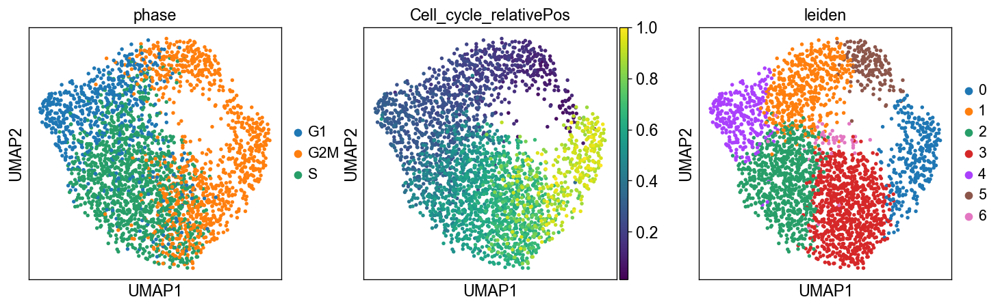

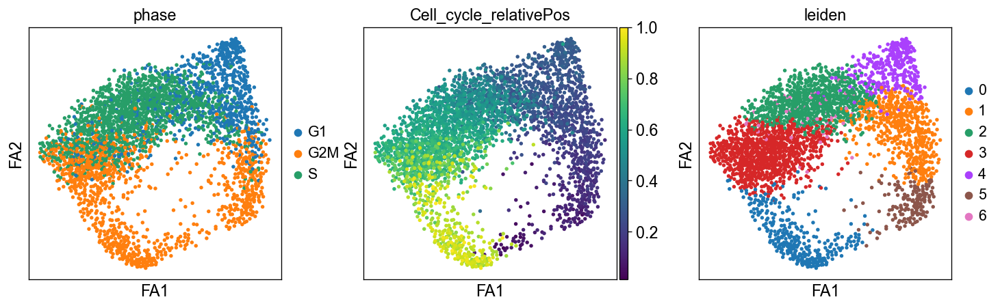

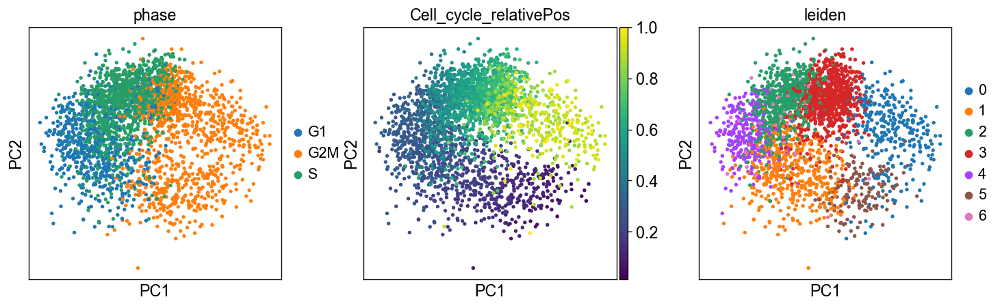

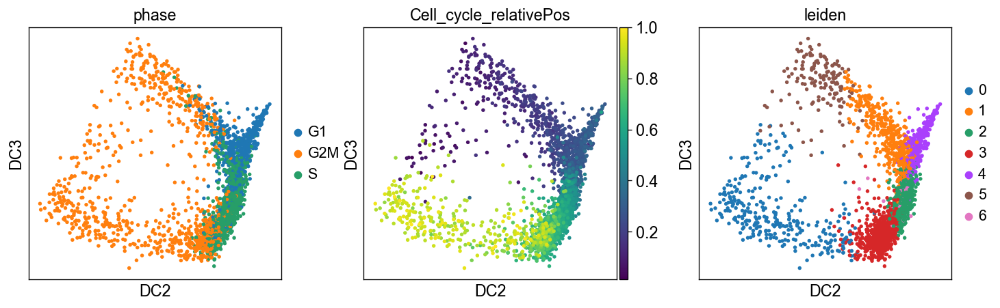

In [25]:
sc.pl.umap(adata, color=['phase', 'Cell_cycle_relativePos', 'leiden', ], )
sc.pl.draw_graph(adata, color=['phase', 'Cell_cycle_relativePos', 'leiden' ,], )
sc.pl.pca(adata, color=['phase', 'Cell_cycle_relativePos', 'leiden' ,], dimensions=[(0,1)], )
sc.pl.diffmap(adata, color=['phase', 'Cell_cycle_relativePos', 'leiden' ,], dimensions=[(1,2)], )

In [26]:
## Remove cluster which seems to not belong
adata = adata[adata.obs.leiden != '6']
adata.obs.leiden
adata

View of AnnData object with n_obs × n_vars = 2745 × 2600
    obs: 'Plate_Id', 'Condition_Id', 'Well_Id', 'RFP_log10_corrected', 'GFP_log10_corrected', 'Cell_cycle_possition', 'Cell_cycle_relativePos', 'exp_type', 'time', 'n_genes', 'sizeF', 'leiden', 'dpt_pseudotime', 'S_score', 'G2M_score', 'phase'
    var: 'Gene_Id', 'query', 'scopes', '_id', '_score', 'symbol', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'leiden', 'iroot', 'diffmap_evals', 'draw_graph', 'tsne', 'phase_colors', 'leiden_colors'
    obsm: 'X_pca', 'X_umap', 'X_diffmap', 'X_draw_graph_fa', 'X_tsne'
    varm: 'PCs'
    layers: 'new', 'old', 'sl', 'spliced', 'su', 'total', 'ul', 'unspliced', 'uu', 'total_su'
    obsp: 'distances', 'connectivities'

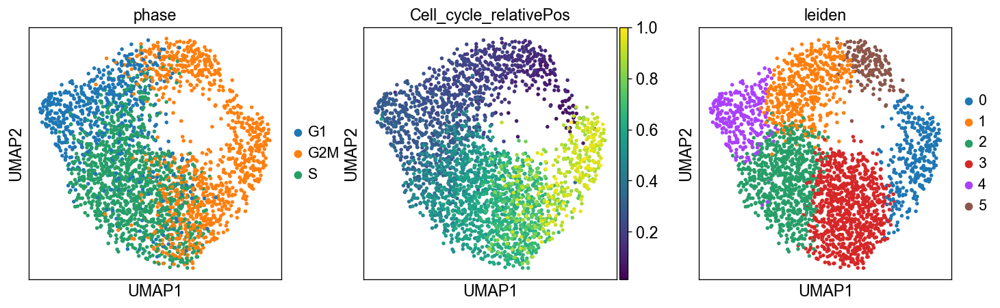

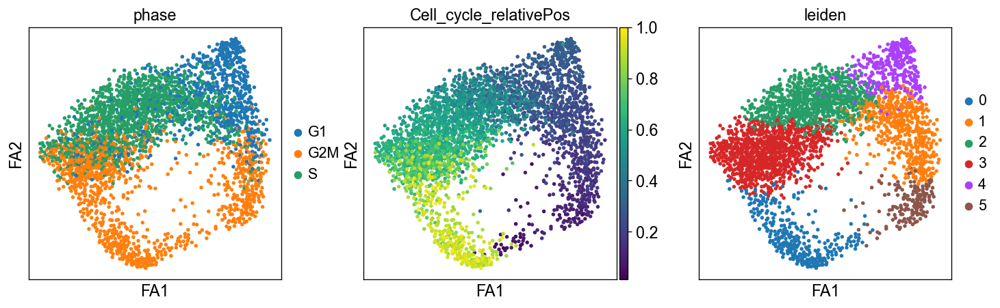

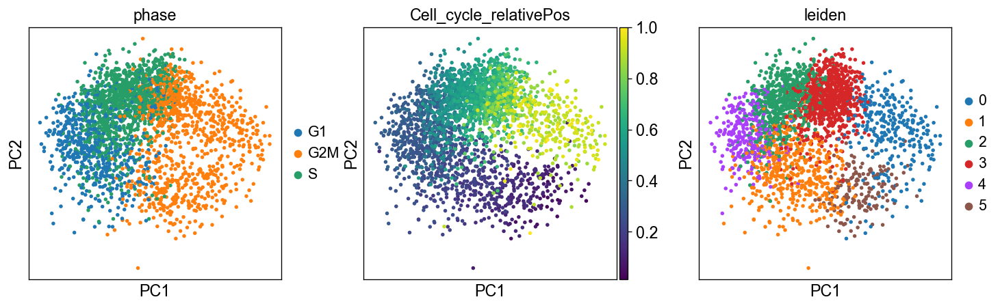

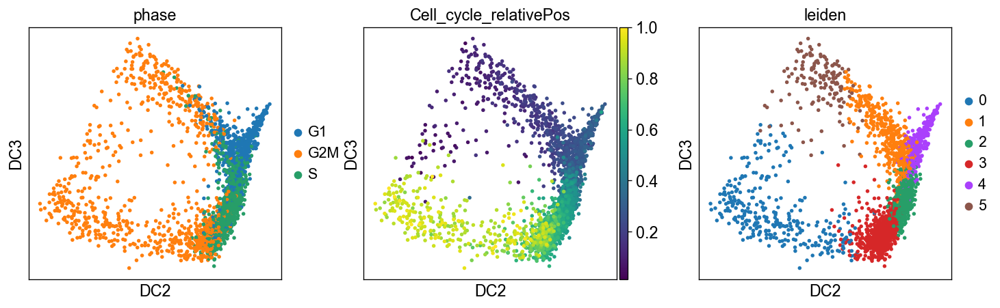

In [27]:
sc.pl.umap(adata, color=['phase', 'Cell_cycle_relativePos', 'leiden', ], )
sc.pl.draw_graph(adata, color=['phase', 'Cell_cycle_relativePos', 'leiden' ,], )
sc.pl.pca(adata, color=['phase', 'Cell_cycle_relativePos', 'leiden' ,], dimensions=[(0,1)], )
sc.pl.diffmap(adata, color=['phase', 'Cell_cycle_relativePos', 'leiden' ,], dimensions=[(1,2)], )

In [28]:
adata

View of AnnData object with n_obs × n_vars = 2745 × 2600
    obs: 'Plate_Id', 'Condition_Id', 'Well_Id', 'RFP_log10_corrected', 'GFP_log10_corrected', 'Cell_cycle_possition', 'Cell_cycle_relativePos', 'exp_type', 'time', 'n_genes', 'sizeF', 'leiden', 'dpt_pseudotime', 'S_score', 'G2M_score', 'phase'
    var: 'Gene_Id', 'query', 'scopes', '_id', '_score', 'symbol', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'leiden', 'iroot', 'diffmap_evals', 'draw_graph', 'tsne', 'phase_colors', 'leiden_colors'
    obsm: 'X_pca', 'X_umap', 'X_diffmap', 'X_draw_graph_fa', 'X_tsne'
    varm: 'PCs'
    layers: 'new', 'old', 'sl', 'spliced', 'su', 'total', 'ul', 'unspliced', 'uu', 'total_su'
    obsp: 'distances', 'connectivities'

In [29]:
adata.obs['time']

Cell_02365    0.25
Cell_02366    0.50
Cell_02367    0.50
Cell_02368    0.50
Cell_02369    0.75
              ... 
Cell_05418    2.00
Cell_05419    2.00
Cell_05420    3.00
Cell_05421    3.00
Cell_05422    3.00
Name: time, Length: 2745, dtype: float64

In [30]:
np.allclose(adata.layers['total'], adata.layers['spliced'] + adata.layers['unspliced'])
#np.allclose(adata.layers['total_su'], adata.layers['spliced'] + adata.layers['unspliced'])

True

In [31]:
adata.layers['RRn'] = sc.pp.normalize_total(adata, layer='total_su', inplace=False)['X']
adata.layers['Sn'] = sc.pp.normalize_total(adata, layer='spliced', inplace=False)['X']
adata.layers['Un'] = sc.pp.normalize_total(adata, layer='unspliced', inplace=False)['X']


adata.layers['RRnl'] = np.log(1 + adata.layers['RRn'])
adata.layers['Snl'] = np.log(1 + adata.layers['Sn'])
adata.layers['Unl'] = np.log(1 + adata.layers['Un'])

scaler = StandardScaler
adata.layers['Sn_st'] = scaler().fit_transform(adata.layers['Sn'])
adata.layers['RRn_st'] = scaler().fit_transform(adata.layers['RRn'])
adata.layers['Un_st'] = scaler().fit_transform(adata.layers['Un'])

adata.layers['Snl_st'] = scaler().fit_transform(adata.layers['Snl'])
adata.layers['RRnl_st'] = scaler().fit_transform(adata.layers['RRnl'])
adata.layers['Unl_st'] = scaler().fit_transform(adata.layers['Unl'])


adata.layers['Rn'] = sc.pp.normalize_total(adata, layer='total', inplace=False)['X']
adata.layers['On'] = sc.pp.normalize_total(adata, layer='old', inplace=False)['X']

adata.layers['Rnl'] = np.nan_to_num(np.log(adata.layers['Rn']), neginf=np.log(1e-1))
adata.layers['Onl'] = np.nan_to_num(np.log(adata.layers['On']), neginf=np.log(1e-1))

reload(slamutils)
slamutils.standardize(
    adata,
    layers=['Rn', 'On', 'Rnl', 'Onl'],
    by_key='time',
    suffix='_sst',
)

adata

AnnData object with n_obs × n_vars = 2745 × 2600
    obs: 'Plate_Id', 'Condition_Id', 'Well_Id', 'RFP_log10_corrected', 'GFP_log10_corrected', 'Cell_cycle_possition', 'Cell_cycle_relativePos', 'exp_type', 'time', 'n_genes', 'sizeF', 'leiden', 'dpt_pseudotime', 'S_score', 'G2M_score', 'phase'
    var: 'Gene_Id', 'query', 'scopes', '_id', '_score', 'symbol', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'leiden', 'iroot', 'diffmap_evals', 'draw_graph', 'tsne', 'phase_colors', 'leiden_colors'
    obsm: 'X_pca', 'X_umap', 'X_diffmap', 'X_draw_graph_fa', 'X_tsne'
    varm: 'PCs'
    layers: 'new', 'old', 'sl', 'spliced', 'su', 'total', 'ul', 'unspliced', 'uu', 'total_su', 'RRn', 'Sn', 'Un', 'RRnl', 'Snl', 'Unl', 'Sn_st', 'RRn_st', 'Un_st', 'Snl_st', 'RRnl_st', 'Unl_st', 'Rn', 'On', 'Rnl', 'Onl', 'Rn_sst', 'On_sst', 'Rnl_sst', 'Onl_sst'
    obsp: 'distances', 'connectivities'

In [32]:
sc.tl.rank_genes_groups(adata, 'leiden', method='wilcoxon', key_added="rank_leiden",)
mygenes = np.array(adata.uns['rank_leiden']['names'][:300].flatten().tolist()).flatten().tolist()
print(len(mygenes), )

1800


In [33]:
n_genes = (len(mygenes) // 100) * 50
n_genes

900

In [34]:
n = adata.n_obs
n_components = 50 
X = adata[:,mygenes[:n_genes]].layers['Onl_sst'].copy() 
Y = adata[:,mygenes[:n_genes]].layers['Rnl_sst'].copy()
dX = Y - X
XY = np.concatenate((X,Y), axis=0)
pca = PCA(n_components=n_components,).fit(XY)
Xp = pca.transform(X)
Yp = pca.transform(Y)
treeX = BallTree(Xp, metric='minkowski', p=2)
k=16
distXX, indXX = treeX.query(Xp, k=k)
Z = X + dX[indXX].mean(1)
Zp = pca.transform(Z)

In [35]:
n = adata.n_obs
np.random.seed(42)
#embd = "X_diffmap"
#embd = "X_pca"
#embd = "X_umap"
#embd = "X_draw_graph_fa"
#embd = "X_tsne"
startind = 1
startind = 2
startind = 0

Y0 = pca.transform(X)[:,startind:]
Y1 = pca.transform(Y)[:,startind:]
Y2 = pca.transform(Z)[:,startind:]

V = (Y1 - Y0)
U = (Y2 - Y0)
V = (Y1 - Y0)[indXX].mean(1)
U = (Y2 - Y0)[indXX].mean(1)

f_medium = 21
f_large = 28


fig, ax = plt.subplots(dpi=300, figsize=(20,13),)

key='cell_type'
key='time'
key='phase'
for phase in np.unique(adata.obs[key].to_numpy()):
    ms = adata.obs[key].to_numpy() == phase
    ax.scatter(
        Y0[:,0][ms],
        Y0[:,1][ms],
        #color = adata.uns['clusters_color_dict'][phase],
        label=str(phase),
    )
    ax.legend(fontsize=f_medium)
ax.set_title("RPE1, hvg genes ((un)labeled)", fontsize=f_large)
ax.set_xlabel('embedding 1', fontsize=f_medium)
ax.set_ylabel('embedding 2', fontsize=f_medium)

mask = np.random.rand(n) > 0.65

ax.quiver(
    Y0[mask,0],
    Y0[mask,1],
    V[mask][:,0],
    V[mask][:,1],
    color="gray",
    angles="xy", scale=1.0e-0, scale_units="xy",pivot='tail',
    width=0.0015,
)

ax.quiver(
    Y0[mask,0],
    Y0[mask,1],
    U[mask][:,0],
    U[mask][:,1],
    color="black",
    angles="xy", scale=1.0e-0, scale_units="xy",pivot='tail',
    width=0.0015,
)

ax.set_xticks([])
ax.set_yticks([])

plt.savefig(f"{save_dir}/rpe1_labeled_pca_diff-drift_exovelo_smooth.pdf", dpi=100, bbox_inches='tight',)

In [36]:
n = adata.n_obs
n_components = 40 
Xs = adata.layers['Snl_st'].copy() 
Ys = adata.layers['RRnl_st'].copy()
Xs = adata[:,mygenes[:n_genes]].layers['Snl_st'].copy() 
Ys = adata[:,mygenes[:n_genes]].layers['RRnl_st'].copy()
dXs = Ys - Xs
XYs = np.concatenate((Xs,Ys), axis=0)
pcas = PCA(n_components=n_components,).fit(XYs)
Xsp = pcas.transform(Xs)
Ysp = pcas.transform(Ys)
treeXs = BallTree(Xsp, metric='minkowski', p=2)
k=16
distXXs, indXXs = treeXs.query(Xsp, k=k)
Zs = Xs + dXs[indXXs].mean(1)
Zps = pcas.transform(Zs)

In [37]:
n = adata.n_obs
np.random.seed(42)
#embd = "X_diffmap"
#embd = "X_pca"
#embd = "X_umap"
#embd = "X_draw_graph_fa"
#embd = "X_tsne"
startind = 1
startind = 2
startind = 0

Y0 = pcas.transform(Xs)[:,startind:]
Y1 = pcas.transform(Ys)[:,startind:]
Y2 = pcas.transform(Zs)[:,startind:]

V = (Y1 - Y0)
U = (Y2 - Y0)
V = (Y1 - Y0)[indXXs].mean(1)
U = (Y2 - Y0)[indXXs].mean(1)

f_medium = 21
f_large = 28


fig, ax = plt.subplots(dpi=300, figsize=(20,13),)

key='cell_type'
key='time'
key='phase'
for phase in np.unique(adata.obs[key].to_numpy()):
    ms = adata.obs[key].to_numpy() == phase
    ax.scatter(
        Y0[:,0][ms],
        Y0[:,1][ms],
        #color = adata.uns['clusters_color_dict'][phase],
        label=str(phase),
    )
    ax.legend(fontsize=f_medium)
ax.set_title("RPE1, hvg genes ((un)spliced)", fontsize=f_large)
ax.set_xlabel('embedding 1', fontsize=f_medium)
ax.set_ylabel('embedding 2', fontsize=f_medium)

mask = np.random.rand(n) > 0.65

ax.quiver(
    Y0[mask,0],
    Y0[mask,1],
    V[mask][:,0],
    V[mask][:,1],
    color="gray",
    angles="xy", scale=1.0e-0, scale_units="xy",pivot='tail',
    width=0.0015,
)

ax.quiver(
    Y0[mask,0],
    Y0[mask,1],
    U[mask][:,0],
    U[mask][:,1],
    color="black",
    angles="xy", scale=1.0e-0, scale_units="xy",pivot='tail',
    width=0.0015,
)

ax.set_xticks([])
ax.set_yticks([])

plt.savefig(f"{save_dir}/rpe1_spliced_pca_diff-drift_exovelo_smooth.pdf", dpi=100, bbox_inches='tight',)

In [38]:
bdata = sc.AnnData(
    X = np.concatenate((X.copy(),Y.copy(),Z.copy()), axis=0),
    obs = {
        'mode' : adata.n_obs * ['present'] +  adata.n_obs * ['diff_drift'] +  adata.n_obs * ['pred_drift'],
        'phase' : np.concatenate([adata.obs['phase'], adata.obs['phase'], adata.obs['phase']], axis=0),
        'time' : np.concatenate([adata.obs['time'], adata.obs['time'], adata.obs['time']], axis=0),
        'Cell_cycle_relativePos' : np.concatenate([adata.obs['Cell_cycle_relativePos'], adata.obs['Cell_cycle_relativePos'], adata.obs['Cell_cycle_relativePos']], axis=0),
    },
    uns = adata[:,mygenes[:n_genes]].uns.copy(),
    var = adata[:,mygenes[:n_genes]].var.copy(),
    )

In [39]:
cdata = sc.AnnData(
    X = np.concatenate((Xs.copy(),Ys.copy(),Zs.copy()), axis=0),
    obs = {
        'mode' : adata.n_obs * ['present'] +  adata.n_obs * ['diff_drift'] +  adata.n_obs * ['pred_drift'],
        'phase' : np.concatenate([adata.obs['phase'], adata.obs['phase'], adata.obs['phase']], axis=0),
        'time' : np.concatenate([adata.obs['time'], adata.obs['time'], adata.obs['time']], axis=0),
        'Cell_cycle_relativePos' : np.concatenate([adata.obs['Cell_cycle_relativePos'], adata.obs['Cell_cycle_relativePos'], adata.obs['Cell_cycle_relativePos']], axis=0),
    },
    uns = adata[:,mygenes[:n_genes]].uns.copy(),
    var = adata[:,mygenes[:n_genes]].var.copy(),
    )

In [40]:
sc.pp.scale(bdata, max_value=10,)
sc.pp.pca(bdata, n_comps=30,)
sc.pp.neighbors(bdata, n_neighbors=20,)
sc.tl.leiden(bdata, flavor="igraph", n_iterations=2, directed=False)
sc.tl.umap(bdata,)
sc.tl.draw_graph(bdata)
bdata.uns['iroot'] = np.flatnonzero(bdata.obs['time'] == 0.25)[0]
sc.tl.diffmap(bdata, )
sc.tl.dpt(bdata, )
#sc.tl.tsne(bdata, )

n = bdata.n_obs
bdata.X.sum(1)

array([ 123.4441129046,   18.1575601972, -169.8537188444, ...,
         10.8801492537,    6.4400981776,   30.0031146829])

In [41]:
sc.pp.scale(cdata, max_value=10,)
sc.pp.pca(cdata, n_comps=30,)
sc.pp.neighbors(cdata, n_neighbors=20,)
sc.tl.leiden(cdata, flavor="igraph", n_iterations=2, directed=False)
sc.tl.umap(cdata,)
sc.tl.draw_graph(cdata)
cdata.uns['iroot'] = np.flatnonzero(cdata.obs['time'] == 0.25)[0]
sc.tl.diffmap(cdata, )
sc.tl.dpt(cdata, )
#sc.tl.tsne(cdata, )

n = cdata.n_obs
cdata.X.sum(1)

array([119.0801379198,  -0.297502058 , -69.2237928464, ...,
       -11.9226014666, -82.3205112179, -44.9987965942])

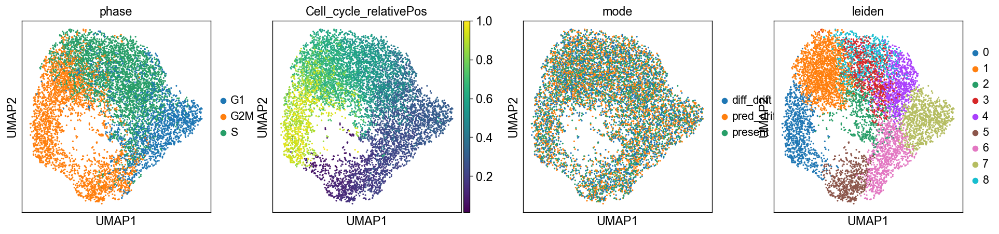

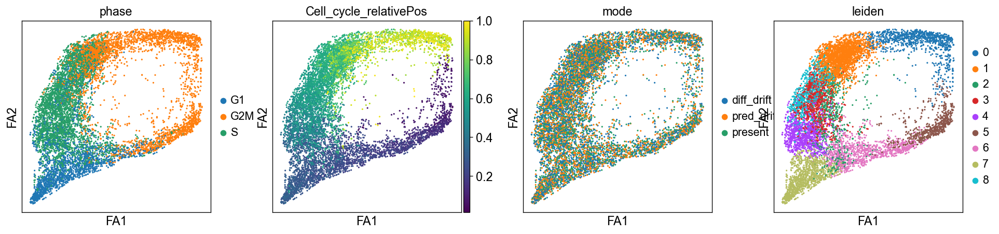

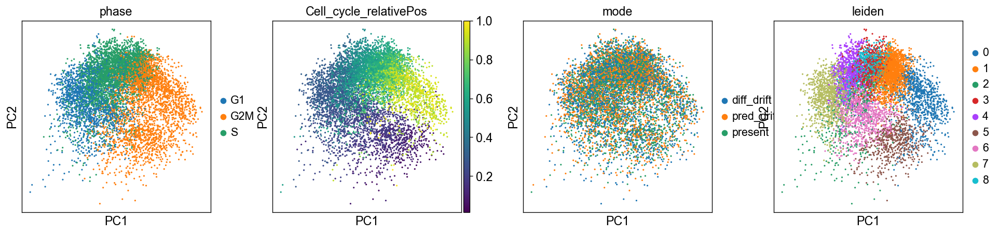

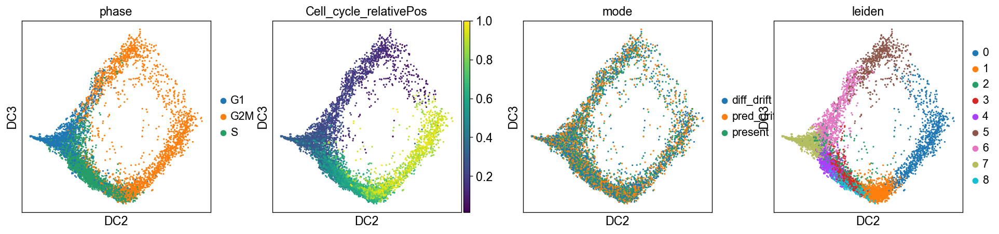

In [42]:
ords = np.arange(bdata.n_obs)
np.random.shuffle(ords)
sc.pl.umap(bdata[ords], color=['phase', 'Cell_cycle_relativePos', 'mode', 'leiden'], ncols=4, )
sc.pl.draw_graph(bdata[ords], color=['phase', 'Cell_cycle_relativePos', 'mode', 'leiden'],ncols=4,  )
sc.pl.pca(bdata[ords], color=['phase', 'Cell_cycle_relativePos', 'mode', 'leiden'],ncols=4, dimensions=[(0,1)], )
sc.pl.diffmap(bdata[ords], color=['phase', 'Cell_cycle_relativePos', 'mode', 'leiden'],ncols=4, dimensions=[(1,2)],  )

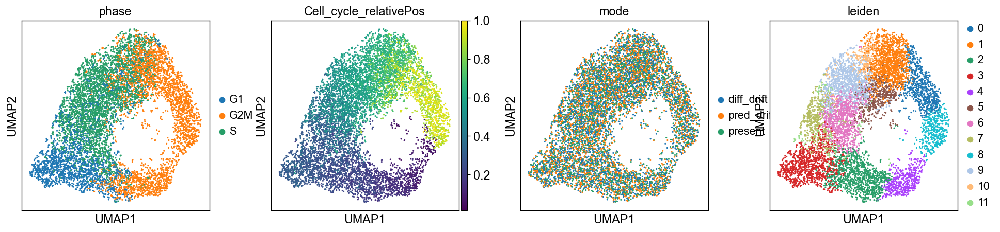

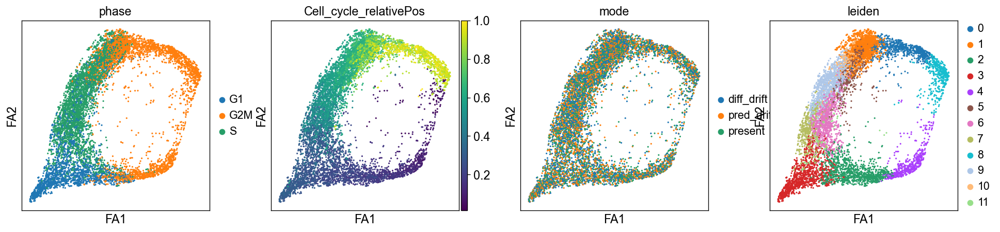

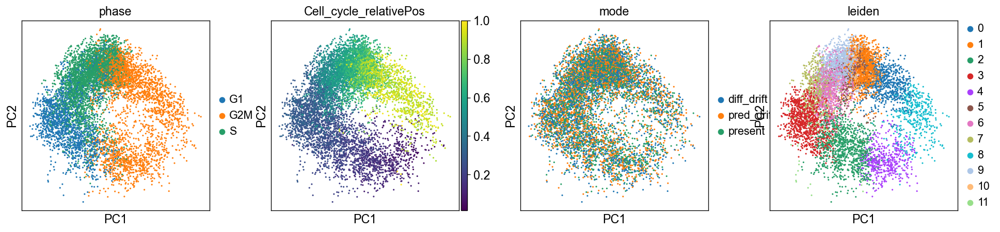

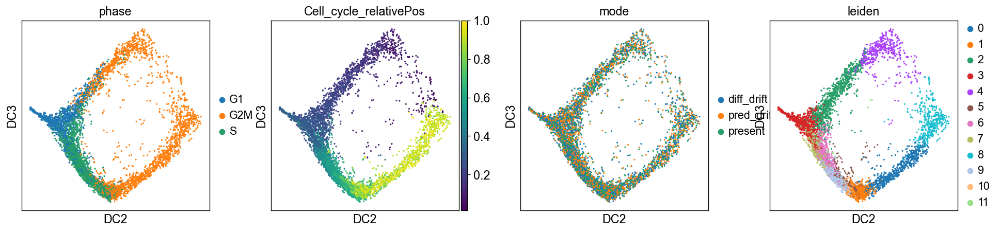

In [43]:
ords = np.arange(cdata.n_obs)
np.random.shuffle(ords)
sc.pl.umap(cdata[ords], color=['phase', 'Cell_cycle_relativePos', 'mode', 'leiden'], ncols=4, )
sc.pl.draw_graph(cdata[ords], color=['phase', 'Cell_cycle_relativePos', 'mode', 'leiden'],ncols=4,  )
sc.pl.pca(cdata[ords], color=['phase', 'Cell_cycle_relativePos', 'mode', 'leiden'],ncols=4, dimensions=[(0,1)], )
sc.pl.diffmap(cdata[ords], color=['phase', 'Cell_cycle_relativePos', 'mode', 'leiden'],ncols=4, dimensions=[(1,2)],  )

In [44]:
n = adata.n_obs
xdata = bdata[:n].copy()
xdata.obsm['velocity_umap'] = bdata[2*n:].obsm['X_umap'] - bdata[:n].obsm['X_umap']
xdata.obsm['velocity_pca'] = bdata[2*n:].obsm['X_pca'] - bdata[:n].obsm['X_pca']
xdata.obsm['velocity_diffmap'] = bdata[2*n:].obsm['X_diffmap'] - bdata[:n].obsm['X_diffmap']
xdata.obsm['velocity_draw_graph_fa'] = bdata[2*n:].obsm['X_draw_graph_fa'] - bdata[:n].obsm['X_draw_graph_fa']

ydata = cdata[:n].copy()
ydata.obsm['velocity_umap'] = cdata[2*n:].obsm['X_umap'] - cdata[:n].obsm['X_umap']
ydata.obsm['velocity_pca'] = cdata[2*n:].obsm['X_pca'] - cdata[:n].obsm['X_pca']
ydata.obsm['velocity_diffmap'] = cdata[2*n:].obsm['X_diffmap'] - cdata[:n].obsm['X_diffmap']
ydata.obsm['velocity_draw_graph_fa'] = cdata[2*n:].obsm['X_draw_graph_fa'] - cdata[:n].obsm['X_draw_graph_fa']

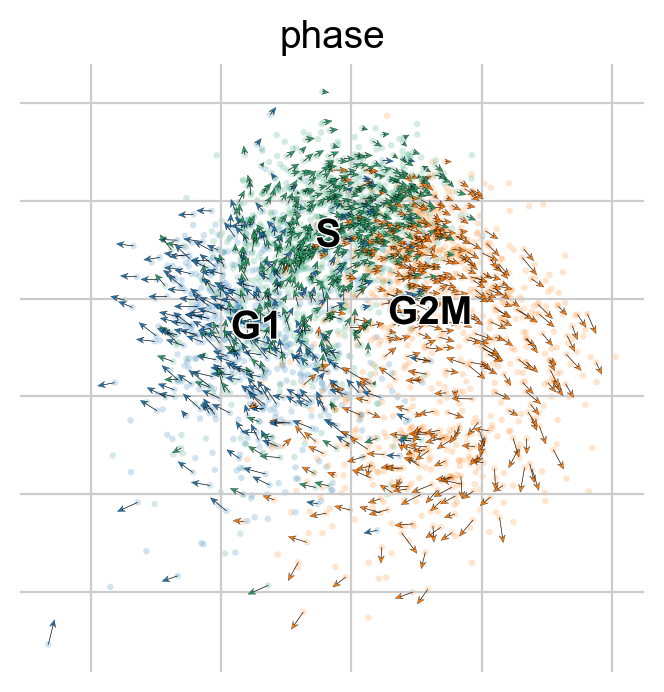

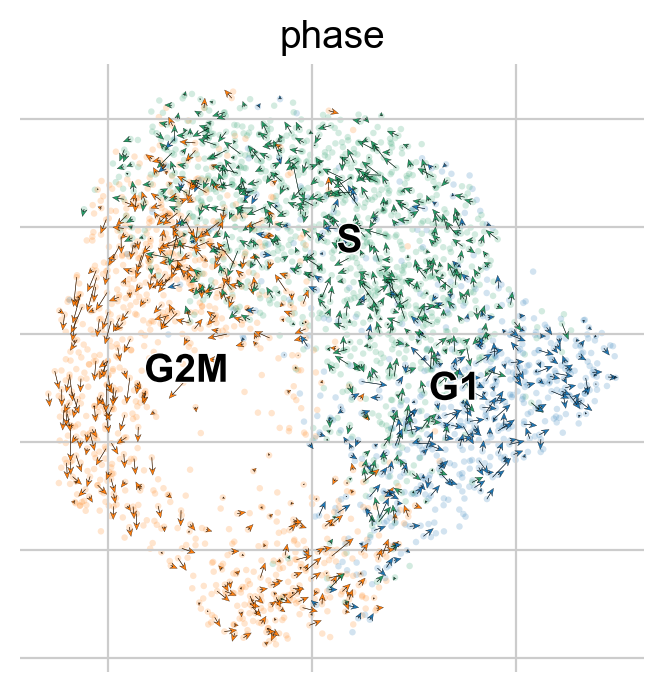

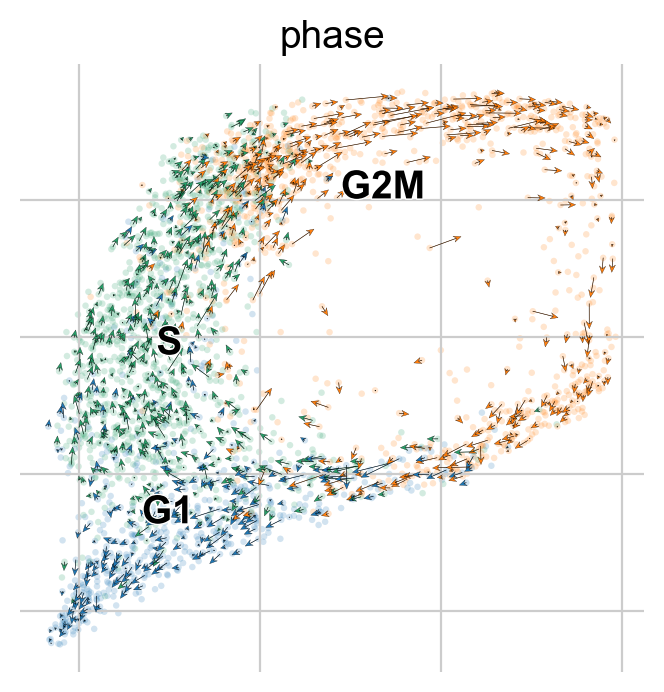

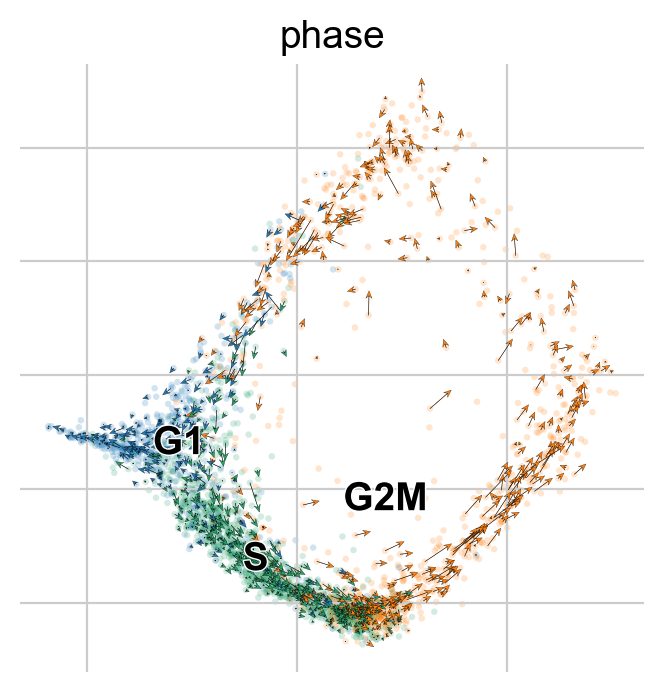

In [45]:
scv.pl.velocity_embedding(xdata, basis='pca', color='phase', dpi=100, density=0.4, arrow_size=2, show=False, legend_loc='on data')
plt.savefig(f"{save_dir}/rpe1_labeled_pca_exovelo.pdf", dpi=100, bbox_inches='tight',)
scv.pl.velocity_embedding(xdata, basis='umap', color='phase', dpi=100, density=0.4, arrow_size=2, show=False, legend_loc='on data')
plt.savefig(f"{save_dir}/rpe1_labeled_umap_exovelo.pdf", dpi=100, bbox_inches='tight',)
scv.pl.velocity_embedding(xdata, basis='draw_graph_fa', color='phase', dpi=100, density=0.4, arrow_size=2, show=False, legend_loc='on data')
plt.savefig(f"{save_dir}/rpe1_labeled_draw_graph_exovelo.pdf", dpi=100, bbox_inches='tight',)
scv.pl.velocity_embedding(xdata, basis='diffmap', color='phase', dpi=100, density=0.4, arrow_size=2, show=False, legend_loc='on data')
plt.savefig(f"{save_dir}/rpe1_labeled_diffmap_exovelo.pdf", dpi=100, bbox_inches='tight',)

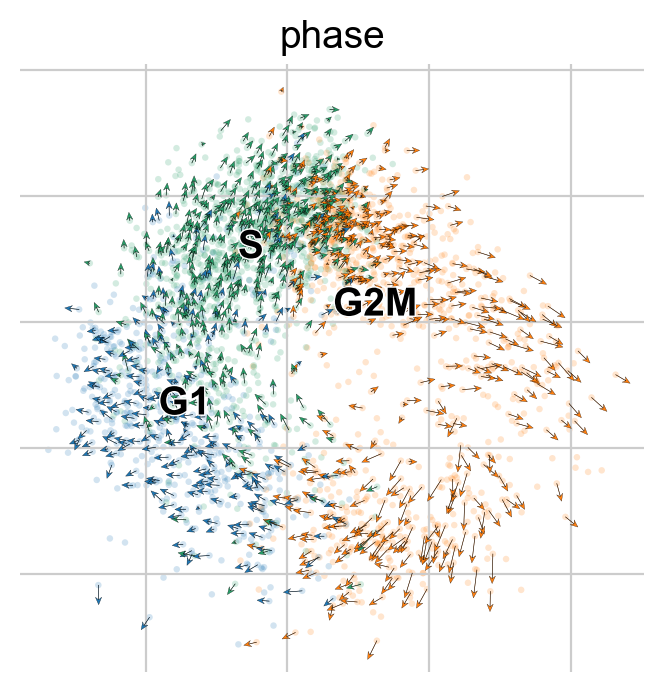

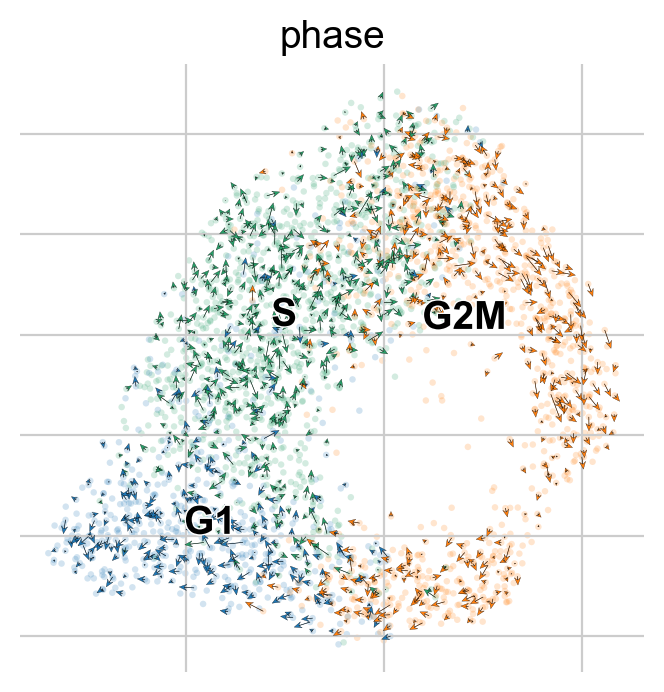

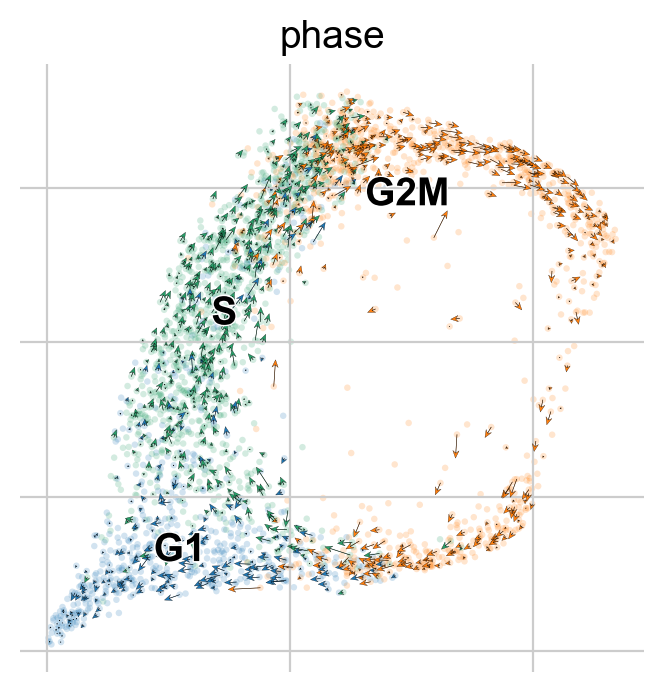

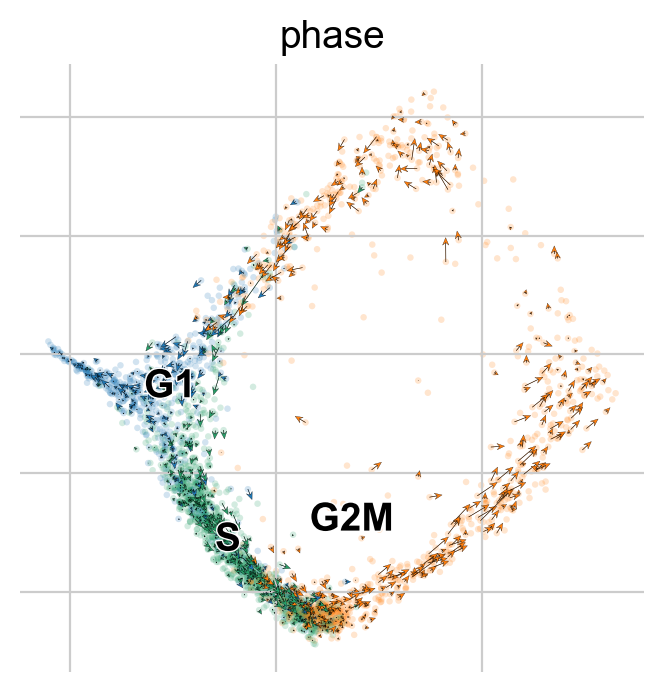

In [46]:
scv.pl.velocity_embedding(ydata, basis='pca', color='phase', dpi=100, density=0.4, arrow_size=2, show=False, legend_loc='on data')
plt.savefig(f"{save_dir}/rpe1_spliced_pca_exovelo.pdf", dpi=100, bbox_inches='tight',)
scv.pl.velocity_embedding(ydata, basis='umap', color='phase', dpi=100, density=0.4, arrow_size=2, show=False, legend_loc='on data')
plt.savefig(f"{save_dir}/rpe1_spliced_umap_exovelo.pdf", dpi=100, bbox_inches='tight',)
scv.pl.velocity_embedding(ydata, basis='draw_graph_fa', color='phase', dpi=100, density=0.4, arrow_size=2, show=False, legend_loc='on data')
plt.savefig(f"{save_dir}/rpe1_spliced_draw_graph_exovelo.pdf", dpi=100, bbox_inches='tight',)
scv.pl.velocity_embedding(ydata, basis='diffmap', color='phase', dpi=100, density=0.4, arrow_size=2, show=False, legend_loc='on data')
plt.savefig(f"{save_dir}/rpe1_spliced_diffmap_exovelo.pdf", dpi=100, bbox_inches='tight',)

<Axes: title={'center': 'time'}>

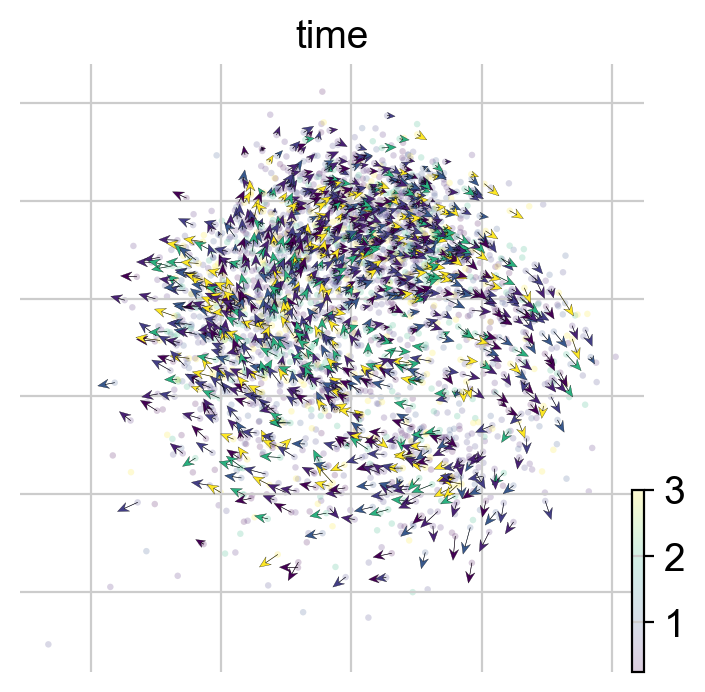

In [47]:
scv.pl.velocity_embedding(xdata, basis='pca', color='time', dpi=100, density=0.4, arrow_size=3,
                          show=False,
                          #legend_loc='on data',
                         )

In [48]:
xdata

AnnData object with n_obs × n_vars = 2745 × 900
    obs: 'mode', 'phase', 'time', 'Cell_cycle_relativePos', 'leiden', 'dpt_pseudotime'
    var: 'Gene_Id', 'query', 'scopes', '_id', '_score', 'symbol', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'leiden', 'iroot', 'diffmap_evals', 'draw_graph', 'tsne', 'phase_colors', 'rank_leiden'
    obsm: 'X_pca', 'X_umap', 'X_draw_graph_fa', 'X_diffmap', 'velocity_umap', 'velocity_pca', 'velocity_diffmap', 'velocity_draw_graph_fa'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

In [49]:
linalg.norm(xdata.obsm['velocity_pca'], axis=1, ord=2)
key='time'
times = np.unique(adata.obs[key].to_numpy())
v_means = []
for phase in np.unique(adata.obs[key].to_numpy()):
    ms = adata.obs[key].to_numpy() == phase
    mean_velolcity = linalg.norm(xdata[ms].obsm['velocity_pca'], axis=1, ord=2).mean()
    v_means.append(mean_velolcity)
    print(f"labeling time ({phase}) mean l2 norm velocity: {mean_velolcity}")

labeling time (0.25) mean l2 norm velocity: 1.3012620210647583
labeling time (0.5) mean l2 norm velocity: 1.3688440322875977
labeling time (0.75) mean l2 norm velocity: 1.3936728239059448
labeling time (1.0) mean l2 norm velocity: 1.4223096370697021
labeling time (2.0) mean l2 norm velocity: 1.4531255960464478
labeling time (3.0) mean l2 norm velocity: 1.4782651662826538


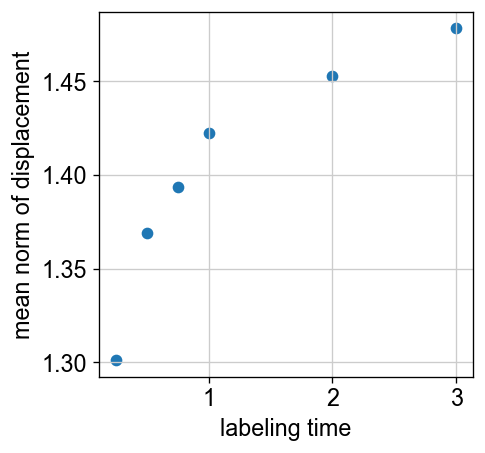

In [50]:
#plt.scatter(times, np.exp(v_means), )
plt.scatter(times, v_means, )
plt.xlabel('labeling time')
plt.ylabel('mean norm of displacement')
plt.savefig(f"{save_dir}/rpe1_labeled_mean_l2_norm_velocity_by_labeling_time_(logarithmized data).pdf", dpi=300, bbox_inches='tight',)

Text(0, 0.5, 'mean velocity (exponentiated)')

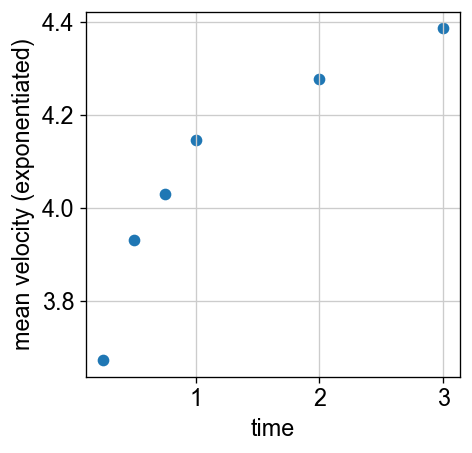

In [51]:
plt.scatter(times, np.exp(v_means), )
plt.xlabel('time')
plt.ylabel('mean velocity (exponentiated)')

In [52]:
linalg.norm(ydata.obsm['velocity_pca'], axis=1, ord=2)
key='time'
times = np.unique(adata.obs[key].to_numpy())
v_means = []
for phase in np.unique(adata.obs[key].to_numpy()):
    ms = adata.obs[key].to_numpy() == phase
    mean_velolcity = linalg.norm(ydata[ms].obsm['velocity_pca'], axis=1, ord=2).mean()
    v_means.append(mean_velolcity)
    print(f"labeling time ({phase}) mean l2 norm velocity: {mean_velolcity}")

labeling time (0.25) mean l2 norm velocity: 1.0955737829208374
labeling time (0.5) mean l2 norm velocity: 1.102695107460022
labeling time (0.75) mean l2 norm velocity: 1.1137032508850098
labeling time (1.0) mean l2 norm velocity: 1.1102864742279053
labeling time (2.0) mean l2 norm velocity: 1.1022086143493652
labeling time (3.0) mean l2 norm velocity: 1.0985125303268433


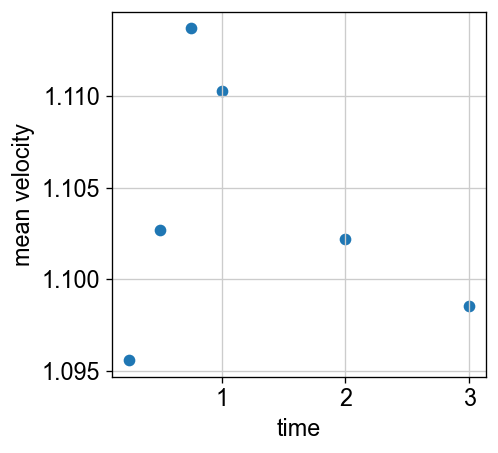

In [53]:
#plt.scatter(times, np.exp(v_means), )
plt.scatter(times, v_means, )
plt.xlabel('time')
plt.ylabel('mean velocity')
plt.savefig(f"{save_dir}/rpe1_spliced_mean_l2_norm_velocity_by_labeling_time_(logarithmized data).pdf", dpi=300, bbox_inches='tight',)

In [54]:
adata.layers['Rnl'].min()

-2.3025850929940455

In [55]:
adata.layers['Onl'].min()

-2.3025850929940455

In [56]:
np.log(1e-1)

-2.3025850929940455

In [57]:
foo = adata.layers['Rn'].copy()
foo = np.where(foo > 0, foo, 100)
foo.min()

0.30269266480965645

In [58]:
np.log(foo.min())

-1.1950372957896809

In [59]:
n = adata.n_obs
n_components = 50 
X = adata[:,mygenes[:n_genes]].layers['Onl_sst'].copy() 
Y = adata[:,mygenes[:n_genes]].layers['Rnl_sst'].copy()
dX = Y - X
XY = np.concatenate((X,Y), axis=0)
pca = PCA(n_components=n_components,).fit(XY)
Xp = pca.transform(X)
Yp = pca.transform(Y)
treeX = BallTree(Xp, metric='minkowski', p=2)
k=16
distXX, indXX = treeX.query(Xp, k=k)
Z = X + dX[indXX].mean(1)
Zp = pca.transform(Z)

dist, ind = treeX.query(Zp, k=k)
rows = np.arange(ind.shape[0]).reshape(-1,1) #rows
#ind = ind[:,1:]
W = np.zeros((len(Xp), len(Xp)))
W[rows, ind] = 1
W[rows, ind] = dist #W[i,j] = j'th neighbor (in X) of Y[i]

In [60]:
S = shortest_path(W)

In [61]:
iroot = np.flatnonzero(adata.obs['phase'] == 'G1')[0]
iroot = np.argmax(adata.obsm['X_draw_graph_fa'][:,1])
iroot = np.argmin(adata.obsm['X_draw_graph_fa'][:,0])
iroot = np.argmin(adata.obsm['X_diffmap'][:,1])
iroot

2013

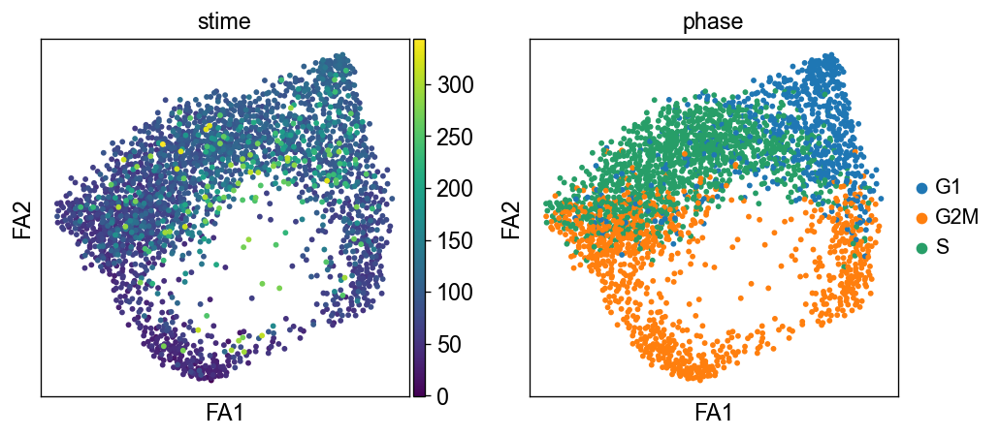

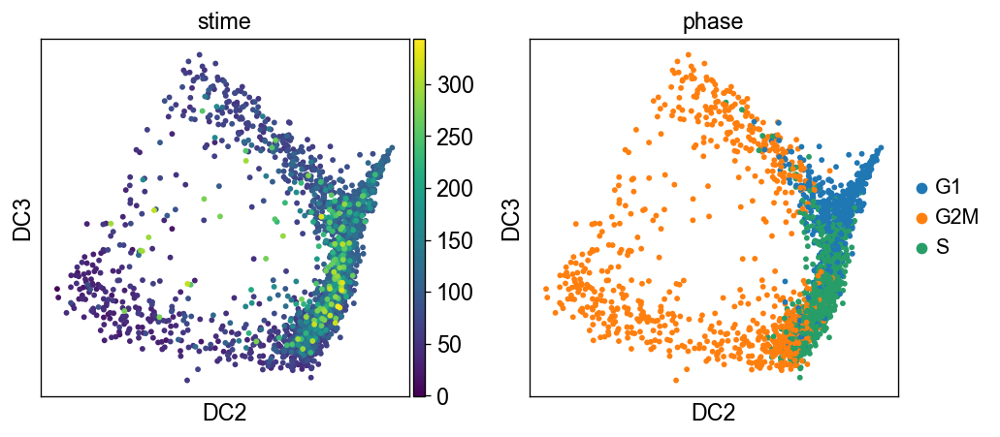

In [62]:
S.max()
adata.obs['stime'] = S[1]
adata.obs['stime'] = S[40]
adata.obs['stime'] = np.log10(0.1 + S[iroot])
adata.obs['stime'] = S[iroot]
adata.obs['stime'][iroot] = -1
ords = np.arange(adata.n_obs)
mask = ~np.isinf(adata.obs['stime']) & (adata.obs['stime'] < 500)
mask = ~np.isinf(adata.obs['stime'])
sc.pl.draw_graph(adata[ords][mask], color=['stime', 'phase'], )
sc.pl.diffmap(adata[ords][mask], color=['stime', 'phase'], dimensions=[(1,2)])
#sc.pl.pca(adata, color=['stime', 'time'])

## Testing Eco-velo style projection instead of JE

In [63]:
n = adata.n_obs
tree = BallTree(Xp[:,:], metric='minkowski', p=2)
k=8
_, ind = tree.query(Zp[:,:], k=k)
_, ind0 = tree.query(Xp[:,:], k=k)
Y0 = ydata[:n].obsm['X_umap']
Y1 = Y0[ind[:,1:]].mean(1)
Y10 = Y0[ind0[:,1:]].mean(1)
V = (Y1 - Y10)
U = (Y1 - Y10)[ind0].mean(1)

adata.obsm['X_umap_prj'] = Y0.copy()
adata.obsm['velocity_umap_prj'] = V.copy()
adata.obsm['X_umap2_prj'] = Y0.copy()
adata.obsm['velocity_umap2_prj'] = U.copy()

In [64]:
adata.obsm

AxisArrays with keys: X_pca, X_umap, X_diffmap, X_draw_graph_fa, X_tsne, X_umap_prj, velocity_umap_prj, X_umap2_prj, velocity_umap2_prj

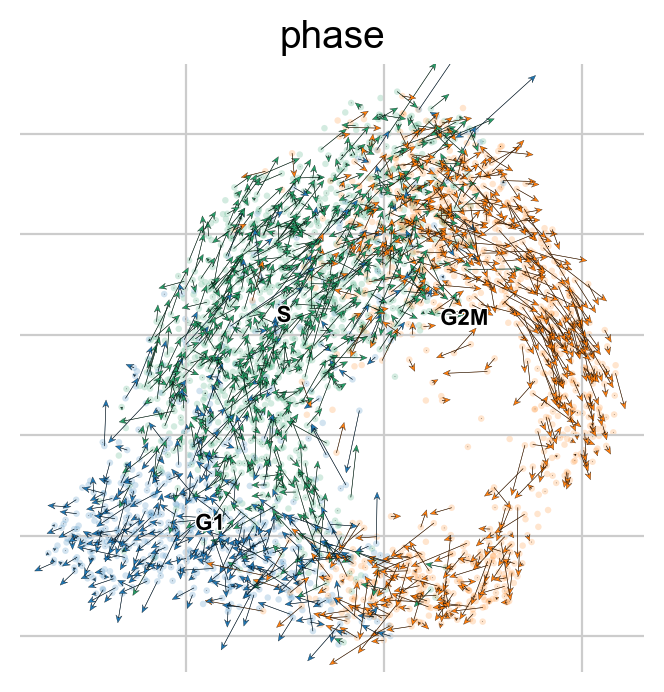

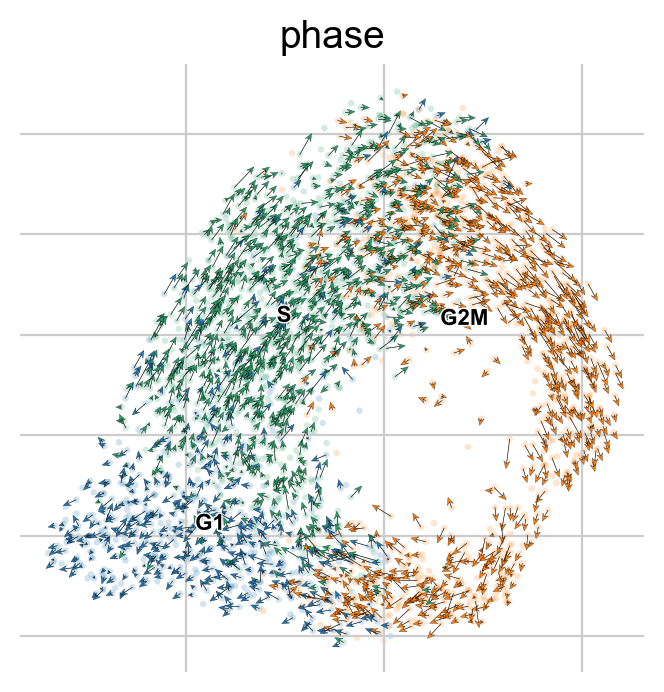

In [66]:
scv.pl.velocity_embedding(adata, basis='umap_prj', color='phase', dpi=100,
                          density=0.75,
                          arrow_size=2,
                          arrow_length=1,
                          show=False,
                          legend_loc='on data',
                          #legend_loc='best',
                          #fontsize=8,
                          legend_fontsize=8,
                         )
plt.savefig(f"{save_dir}/rpe1_labeled_umap_exovelo_prj_orig.pdf", dpi=100, bbox_inches='tight',)

scv.pl.velocity_embedding(adata, basis='umap2_prj', color='phase', dpi=100,
                          density=0.75,
                          arrow_size=2,
                          arrow_length=1,
                          show=False,
                          legend_loc='on data',
                          #legend_loc='best',
                          #fontsize=8,
                          legend_fontsize=8,
                         )
plt.savefig(f"{save_dir}/rpe1_labeled_umap_exovelo_smooth_prj_orig.pdf", dpi=100, bbox_inches='tight',)
#
#scv.pl.velocity_embedding(adata, basis='umap', color='phase', dpi=300,
#                          density=0.75,
#                          arrow_size=2,
#                          arrow_length=1,
#                          show=False,
#                          legend_loc='on data',
#                          #legend_loc='best',
#                          #fontsize=8,
#                          legend_fontsize=8,
#                         )
#plt.savefig(f"{save_dir}/rpe1_labeled_umap_exovelo_smooth_prj_orig.pdf", dpi=300, bbox_inches='tight',)

In [67]:
np.unique(adata.obs['time'])

array([0.25, 0.5 , 0.75, 1.  , 2.  , 3.  ])